# Prueba precisión del clasificador ternario

Para comenzar a estudiar como funciona el método alternado para clasificación entre tres colores, se estudia su presición para grillas de $5\times5$ con distintos porcentajes de casillas verde (en un inicio para distribución equitativa entre azul y rojo)

En este caso, habrían $25$ casillas, por lo que hay mayoría con $>9$ cuadros verdes. Considerando $n=\,\text{N° de verdes}$ los valores a probar serán:
$n=1, 3, 5, 7, 9, 11$

In [1]:
import numpy as np
from modules.ternary_classifier import TernaryClassifier
import matplotlib.pyplot as plt

In [2]:
R = np.array([1, 0, 0])
G = np.array([0, 1, 0])
B = np.array([0, 0, 1])

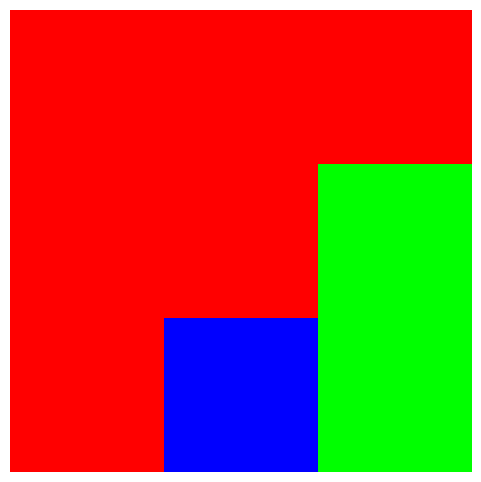

In [3]:
R = np.array([1, 0, 0])
G = np.array([0, 1, 0])
B = np.array([0, 0, 1])


x0 = np.array([
    [R, R, R],
    [R, R, G],
    [R, B, G],
])
c = TernaryClassifier(x0, 1e-2, 100, 1)
# c.alternated_step()
c.show()

array([[1, 0, 0],
       [0, 0, 1],
       [1, 0, 0],
       [0, 0, 1],
       [1, 0, 0],
       [1, 0, 0],
       [0, 0, 1],
       [0, 0, 1],
       [0, 0, 1],
       [0, 0, 1],
       [0, 0, 1],
       [1, 0, 0],
       [0, 0, 1],
       [1, 0, 0],
       [0, 0, 1],
       [1, 0, 0],
       [0, 0, 1],
       [1, 0, 0],
       [1, 0, 0],
       [1, 0, 0],
       [0, 0, 1],
       [1, 0, 0],
       [0, 0, 1],
       [0, 1, 0],
       [1, 0, 0]])

Processing pixel (0, 0) with neighbors: [(0, 0), (4, 0), (0, 4), (0, 1), (1, 0)]
neighbor_values_r: 3
neighbor_values_g: 0
neighbor_values_b: 2
Processing pixel (0, 1) with neighbors: [(0, 1), (4, 1), (0, 0), (0, 2), (1, 1)]
neighbor_values_r: 1
neighbor_values_g: 0
neighbor_values_b: 4
Processing pixel (0, 2) with neighbors: [(0, 2), (4, 2), (0, 1), (0, 3), (1, 2)]
neighbor_values_r: 2
neighbor_values_g: 0
neighbor_values_b: 3
Processing pixel (0, 3) with neighbors: [(0, 3), (4, 3), (0, 2), (0, 4), (1, 3)]
neighbor_values_r: 2
neighbor_values_g: 1
neighbor_values_b: 2
Processing pixel (0, 4) with neighbors: [(0, 4), (4, 4), (0, 3), (0, 0), (1, 4)]
neighbor_values_r: 4
neighbor_values_g: 0
neighbor_values_b: 1
Processing pixel (1, 0) with neighbors: [(1, 0), (0, 0), (1, 4), (1, 1), (2, 0)]
neighbor_values_r: 3
neighbor_values_g: 0
neighbor_values_b: 2
Processing pixel (1, 1) with neighbors: [(1, 1), (0, 1), (1, 0), (1, 2), (2, 1)]
neighbor_values_r: 3
neighbor_values_g: 0
neighbor_valu

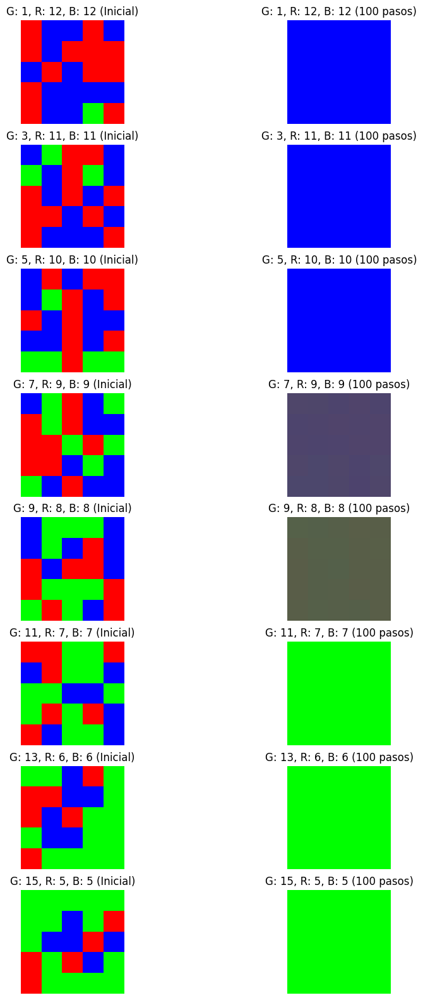

In [33]:
x0 = np.array([G] + 12*[R] + 12*[B])
def create_x0(n, size):
    x0 = np.array(n*[G] + (size**2-n)//2*[R] + (size**2-n)//2*[B])
    np.random.shuffle(x0)
    x0 = x0.reshape((size, size, 3))
    return x0
size = 5
g_numbers = [1, 3, 5, 7, 9, 11, 13, 15]
fig, axs = plt.subplots(len(g_numbers), 2, figsize=(10, 20))
for i, n in enumerate(g_numbers):
    x0 = create_x0(n, size)
    c = TernaryClassifier(x0, 1e-2, 100, 1)
    c.show(ax=axs[i, 0])
    axs[i, 0].set_title(f'G: {n}, R: {(size**2-n)//2}, B: {(size**2-n)//2} (Inicial)')
    axs[i, 0].axis('off')
    for _ in range(200): 
        c.alternated_step()
    c.show(ax=axs[i, 1])
    axs[i, 1].set_title(f'G: {n}, R: {(size**2-n)//2}, B: {(size**2-n)//2} (100 pasos)')
    axs[i, 1].axis('off')

El clasificador se porta bien cuando el número de verdes está bajo $\lfloor\rho_c\rfloor -1$ y sobre $\lceil\rho_c\rceil +1$. Vale la pena preguntarse si los casos borde $G: 9$ y $G: 7$ convergen con mas pasos

Processing pixel (0, 0) with neighbors: [(0, 0), (4, 0), (0, 4), (0, 1), (1, 0)]
neighbor_values_r: 2
neighbor_values_g: 0
neighbor_values_b: 3
Processing pixel (0, 1) with neighbors: [(0, 1), (4, 1), (0, 0), (0, 2), (1, 1)]
neighbor_values_r: 3
neighbor_values_g: 1
neighbor_values_b: 1
Processing pixel (0, 2) with neighbors: [(0, 2), (4, 2), (0, 1), (0, 3), (1, 2)]
neighbor_values_r: 3
neighbor_values_g: 2
neighbor_values_b: 0
Processing pixel (0, 3) with neighbors: [(0, 3), (4, 3), (0, 2), (0, 4), (1, 3)]
neighbor_values_r: 2
neighbor_values_g: 2
neighbor_values_b: 1
Processing pixel (0, 4) with neighbors: [(0, 4), (4, 4), (0, 3), (0, 0), (1, 4)]
neighbor_values_r: 2
neighbor_values_g: 0
neighbor_values_b: 3
Processing pixel (1, 0) with neighbors: [(1, 0), (0, 0), (1, 4), (1, 1), (2, 0)]
neighbor_values_r: 2
neighbor_values_g: 0
neighbor_values_b: 3
Processing pixel (1, 1) with neighbors: [(1, 1), (0, 1), (1, 0), (1, 2), (2, 1)]
neighbor_values_r: 4
neighbor_values_g: 0
neighbor_valu

KeyboardInterrupt: 

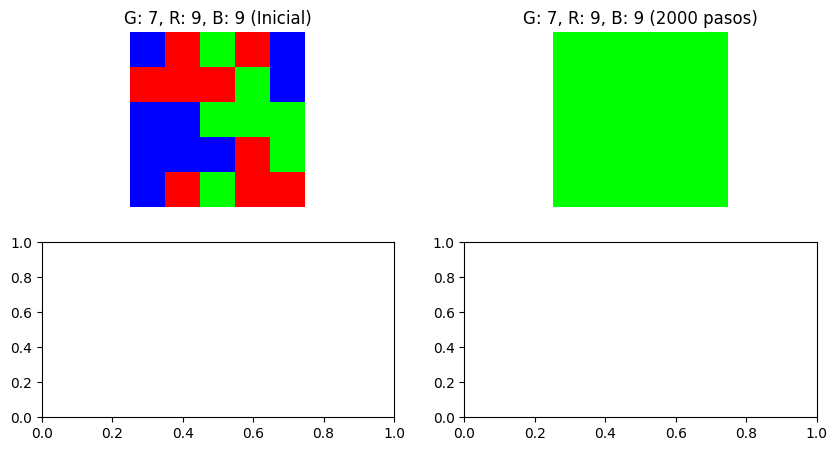

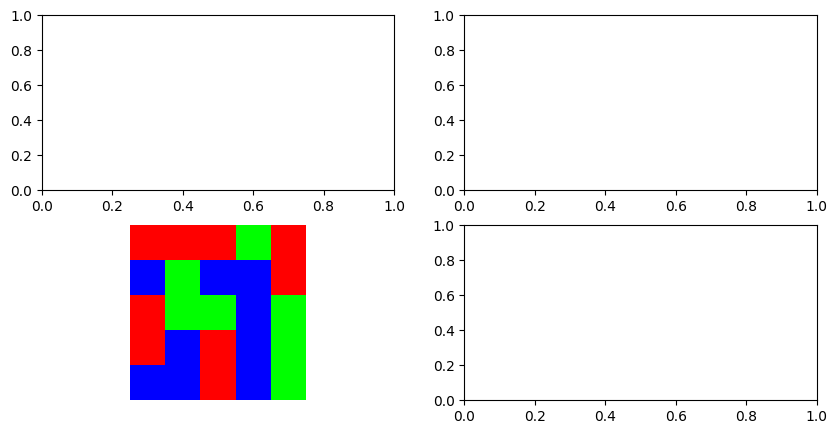

In [40]:
x7 = create_x0(7, 5)
c = TernaryClassifier(x7, 1e-2, 100, 1)
fig, axs = plt.subplots(2, 2, figsize=(10, 5))
c.show(ax=axs[0,0])

for _ in range(2000):
    c.alternated_step()
    
c.show(ax=axs[0,1])
axs[0,0].set_title('G: 7, R: 9, B: 9 (Inicial)')
axs[0,1].set_title('G: 7, R: 9, B: 9 (2000 pasos)')
axs[0,0].axis('off')
axs[0,1].axis('off')

x7 = create_x0(7, 5)
c = TernaryClassifier(x7, 1e-2, 100, 1)
fig, axs = plt.subplots(2, 2, figsize=(10, 5))
c.show(ax=axs[1,0])

for _ in range(2000):
    c.alternated_step()
    
c.show(ax=axs[1,1])
axs[1,0].set_title('G: 7, R: 9, B: 9 (Inicial)')
axs[1,1].set_title('G: 7, R: 9, B: 9 (2000 pasos)')
axs[1,0].axis('off')
axs[1,1].axis('off')
fig.suptitle("Dos intentos distintos para el caso 7 verdes", fontsize=16)
fig.show()